# Physics 641 - Extension Project

## Tucker Knaak - Department of Physics, Creighton University - Spring 2024

#### In Homework 3, we examined Monte Carlo simulations of one-dimensional random walks.  We investigated how the histogram changed when the number of walks or the number of steps was varied and then approximated the probability of moving in a certain direction from given data.  In this extension project, we will consider a large number of walks and steps.  We will animate chosen paths of the random walks as well as the histogram of displacement to see how these visualizations change with time (number of steps).

In [1]:
'''Required Libraries'''
import matplotlib.animation as animation
import matplotlib.pyplot as plt
import numpy as np
import matplotlib

'''Required Functions'''
from IPython.display import HTML, display

'''Adjust Animation Size'''
matplotlib.rcParams['animation.embed_limit'] = 2**128

#### This cell includes the class necessary to compute the Monte Carlo simulations and animate the paths and histogram.

In [2]:
class bernoulli_processes():
    
    '''Internal function to initialize the system and store relevant data'''
    def __init__(self, num_walks: int, num_steps: int, p: float, q: float):
        
        '''Initial conditions'''
        self.p = p                  #probability of moving to the right for each step
        self.q = q                  #probability of moving to the left for each step
        self.num_steps = num_steps  #number of steps for each random walk
        self.num_walks = num_walks  #number of random walks for the Monte Carlo simulation
        
        '''Data for paths'''
        self.all_paths = []                                     #all paths of the random walks
        self.selected_paths = []                                #6 selected paths for the animation
        self.steps = [step for step in range(num_steps + 1)]    #list of steps for all paths
        self.colors = plt.cm.viridis(np.linspace(0.1, 0.9, 6))  #colors for the 6 selected paths
        
        '''Data for histogram'''
        self.bins = []                                            #arranged bins for the histogram
        self.displacements = []                                   #all final displacements of the random walks
        self.max_displacement = 0                                 #maximum final displacement of all paths
        self.color = plt.cm.viridis(np.random.uniform(0.1, 0.9))  #color for the histogram
        
        
    '''Function called by the user to conduct a given number of random walks of a given number of steps'''
    def random_walks(self):
        
        '''Conduct given number of random walks'''
        for walk in range(self.num_walks):
            
            '''Initial conditions'''
            displacement = 0       #final displacement of each random walk
            path = [displacement]  #path of each random walk
            
            '''Move right // move left'''
            for step in range(self.num_steps):
                rnd = np.random.rand()     #random float in [0, 1)
                if rnd <= self.p:
                    displacement += 1      #move right
                else:
                    displacement -= 1      #move left
                path.append(displacement)  #append total displacement at each step
                
            '''Append complete path and final displacement'''
            self.all_paths.append(path)
            self.displacements.append(displacement)
            
        '''Select paths with small // large final displacements'''
        sorted_walks = sorted(range(len(self.displacements)), key = lambda d: abs(self.displacements[d]))
        indices = sorted_walks[:3] + sorted_walks[-3:]  #3 paths with small // large displacements
        self.selected_paths = [self.all_paths[index] for index in indices]
        
        '''Find maximum final displacement // create bins'''
        self.max_displacement = max([abs(d) for d in self.displacements])
        self.bins = np.arange(-self.max_displacement - 1.5, self.max_displacement + 2.5, 2)
        
        
    '''Function called by the user to plot the 6 selected paths of the random walks'''
    def plot_paths(self, save_fig = False):
        
        '''Create figure'''
        fig, ax = plt.subplots(1, 1, figsize = (8, 5))
        fig.tight_layout(pad = 4)
        ax.set_xlabel('Steps')
        ax.set_ylabel('Displacement')
        ax.set_title(f'6 Paths of the {self.num_walks} Random Walks of {self.num_steps} Steps')
        ax.set_ylim(-self.max_displacement - 3, self.max_displacement + 3)
        ax.grid(True, linestyle = 'dashed', color = 'darkgray', alpha = 0.25)
        ax.annotate(f'p = {self.p:.2f}\nq = {self.q:.2f}', xy = (0.065, 0.925), xycoords = 'axes fraction', ha = 'center',
                    va = 'center', bbox = dict(boxstyle = 'square', edgecolor = 'black', facecolor = 'none'))
        
        '''Plot results'''
        for index, path in enumerate(self.selected_paths):
            ax.plot(self.steps, path, color = self.colors[index])
            
        '''Save figure'''
        if save_fig:
            fig.savefig(f'c:/Users/Tucker Knaak/Downloads/{self.num_walks}Trials{self.num_steps}StepsPaths.png')
            
            
    '''Internal function to update the animation of the 6 selected paths of the random walks'''
    def update_paths(self, step: int, *paths):
        
        '''Update number of steps'''
        for path, selected_path in zip(paths, self.selected_paths):
            path.set_data(self.steps[:step], selected_path[:step])
            
        '''Return artist elements'''
        return paths
    
    
    '''Function called by the user to animate the 6 selected paths of the random walks'''
    def animate_paths(self, save_fig = False):
        
        '''Create figure'''
        fig, ax = plt.subplots(1, 1, figsize = (8, 5))
        fig.tight_layout(pad = 4)
        ax.set_xlabel('Steps')
        ax.set_ylabel('Displacement')
        ax.set_title(f'6 Paths of the {self.num_walks} Random Walks of {self.num_steps} Steps')
        ax.set_ylim(-self.max_displacement - 3, self.max_displacement + 3)
        ax.grid(True, linestyle = 'dashed', color = 'darkgray', alpha = 0.25)
        ax.annotate(f'p = {self.p:.2f}\nq = {self.q:.2f}', xy = (0.065, 0.925), xycoords = 'axes fraction', ha = 'center',
                    va = 'center', bbox = dict(boxstyle = 'square', edgecolor = 'black', facecolor = 'none'))
        
        '''Paths to be updated'''
        paths = [ax.plot(self.steps, path, color = color)[0] for path, color in zip(self.selected_paths, self.colors)]
        
        '''Create animation'''
        ani = animation.FuncAnimation(fig, self.update_paths, frames = range(0, self.num_steps + 5, 4), interval = 25,
                                      fargs = paths, repeat = False)
        html = HTML(ani.to_jshtml())
        display(html)
        plt.close()
        
        '''Save animation'''
        if save_fig:
            f = r'c:/Users/Tucker Knaak/Downloads/{trials}Trials{steps}StepsPaths.gif'.format(
                trials = self.num_walks, steps = self.num_steps)
            writergif = animation.PillowWriter(fps = self.num_steps // 5)
            ani.save(f, writer = writergif)
            
            
    '''Function called by the user to plot the histogram of the final displacements of the random walks'''
    def plot_histogram(self, save_fig = False):
        
        '''Create figure'''
        fig, ax = plt.subplots(1, 1, figsize = (8, 5))
        fig.tight_layout(pad = 4)
        ax.set_xlabel('Displacement')
        ax.set_ylabel('Frequency')
        ax.set_title(f'Histogram of the {self.num_walks} Random Walks of {self.num_steps} Steps')
        ax.grid(True, linestyle = 'dashed', color = 'darkgray', alpha = 0.25)
        ax.annotate(f'p = {self.p:.2f}\nq = {self.q:.2f}', xy = (0.065, 0.925), xycoords = 'axes fraction', ha = 'center',
                    va = 'center', bbox = dict(boxstyle = 'square', edgecolor = 'black', facecolor = 'none'))
        
        '''Plot results'''
        ax.hist(self.displacements, bins = self.bins, color = self.color, edgecolor = 'black')
        
        '''Save figure'''
        if save_fig:
            fig.savefig(f'c:/Users/Tucker Knaak/Downloads/{self.num_walks}Trials{self.num_steps}StepsHistogram.png')
            
            
    '''Internal function to update the animation of the histogram of the displacements of the random walks'''
    def update_histogram(self, step: int, fig, ax):
        
        '''Clear last figure'''
        ax.clear()
        
        '''New figure'''
        fig.tight_layout(pad = 4)
        ax.set_xlabel('Displacement')
        ax.set_ylabel('Frequency')
        ax.set_title(f'Histogram of the {self.num_walks} Random Walks of {self.num_steps} Steps')
        ax.grid(True, linestyle = 'dashed', color = 'darkgray', alpha = 0.25)
        ax.annotate(f'p = {self.p:.2f}\nq = {self.q:.2f}', xy = (0.065, 0.925), xycoords = 'axes fraction', ha = 'center',
                    va = 'center', bbox = dict(boxstyle = 'square', edgecolor = 'black', facecolor = 'none'))
        ax.annotate(f'Step: {step}', xy = (0.93, 0.945), xycoords = 'axes fraction', ha = 'center',
                    va = 'center', bbox = dict(boxstyle = 'square', edgecolor = 'black', facecolor = 'none'))
        
        '''Update number of steps'''
        displacements = [path[step] for path in self.all_paths]
        _, _, patches = ax.hist(displacements, bins = self.bins, color = self.color, edgecolor = 'black')
        
        '''Return artist elements'''
        return patches
    
    
    '''Function called by the user to animate the histogram of the displacements of the random walks'''
    def animate_histogram(self, save_fig = False):
        
        '''Create figure'''
        fig, ax = plt.subplots(1, 1, figsize = (8, 5))
        fig.tight_layout(pad = 4)
        ax.set_xlabel('Displacement')
        ax.set_ylabel('Frequency')
        ax.set_title(f'Histogram of the {self.num_walks} Random Walks of {self.num_steps} Steps')
        ax.grid(True, linestyle = 'dashed', color = 'darkgray', alpha = 0.25)
        ax.annotate(f'p = {self.p:.2f}\nq = {self.q:.2f}', xy = (0.065, 0.925), xycoords = 'axes fraction', ha = 'center',
                    va = 'center', bbox = dict(boxstyle = 'square', edgecolor = 'black', facecolor = 'none'))
        
        '''Create animation'''
        ani = animation.FuncAnimation(fig, self.update_histogram, frames = range(0, self.num_steps + 4, 4),
                                      interval = 25, fargs = (fig, ax), repeat = False)
        
        html = HTML(ani.to_jshtml())
        display(html)
        plt.close()
        
        '''Save animation'''
        if save_fig:
            f = r'c:/Users/Tucker Knaak/Downloads/{trials}Trials{steps}StepsHistogram.gif'.format(
                trials = self.num_walks, steps = self.num_steps)
            writergif = animation.PillowWriter(fps = self.num_steps // 5)
            ani.save(f, writer = writergif)

#### Consider $1000$ random walks of $100$ steps with a probability of moving right of $p=0.7$.

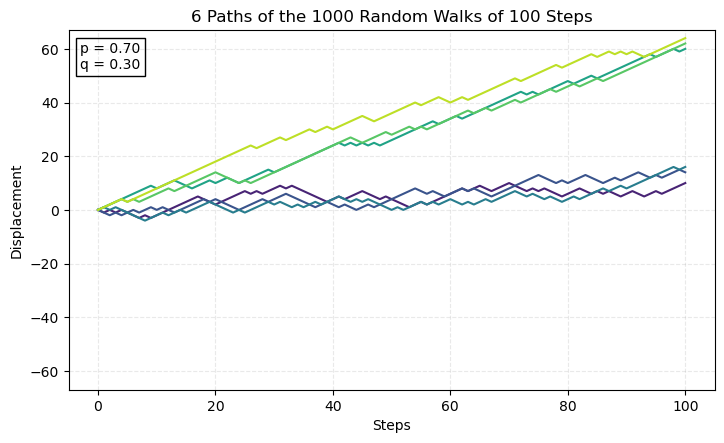

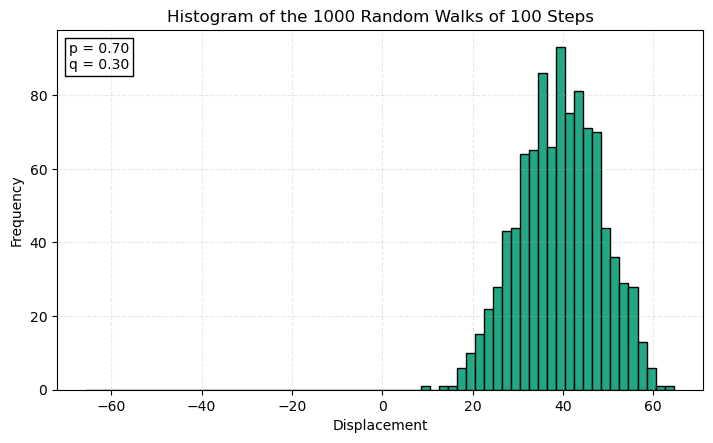

In [3]:
ex1 = bernoulli_processes(1000, 100, 0.7, 0.3)
ex1.random_walks()
ex1.plot_paths(save_fig = True)
ex1.plot_histogram(save_fig = True)

In [4]:
ex1.animate_paths(save_fig = True)

In [5]:
ex1.animate_histogram(save_fig = True)

#### Consider $100000$ random walks of $500$ steps with a probability of moving right of $p=0.5$.

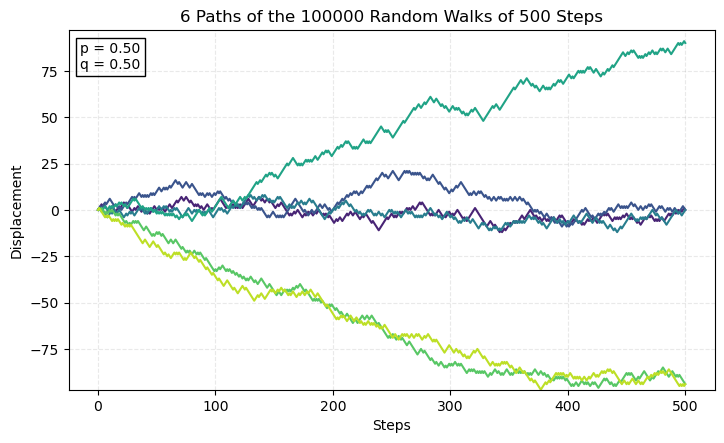

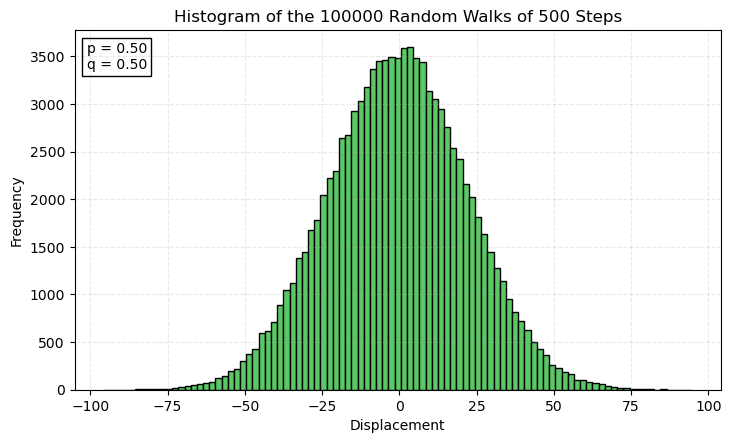

In [6]:
ex2 = bernoulli_processes(100000, 500, 0.5, 0.5)
ex2.random_walks()
ex2.plot_paths(save_fig = True)
ex2.plot_histogram(save_fig = True)

In [7]:
ex2.animate_paths(save_fig = True)

In [8]:
ex2.animate_histogram(save_fig = True)